Experimental Dataset - 3D - 128x128

# Setup

In [1]:
%matplotlib inline
import os, sys, glob, shutil
from matplotlib import pyplot as plt
import numpy as np
import torch
import h5py
from sklearn import metrics
from scipy.stats import special_ortho_group
from scipy.optimize import curve_fit
from IPython.display import Image
sys.path.append('../utils/')
import functions_for_fred as fn
import nn
import viz
import pred

In [2]:
fig_force_update_master=False

In [3]:
CLASS_NUMBER = '180x180' #93
L            = 6
EPOCH_NUMBER = 240
CHECKPTH_KEY = 'cone_'
DATA_KEY     = '3d' #'class_2d_{}'.format(CLASS_NUMBER)
METADATA_KEY = 'refine3D'   #'class2D'

In [4]:
# no need to edit this cell
KEYWORD      = 'cryo_exp_{}_128x128'.format(DATA_KEY)
CHECKPT_FILE = 'cryo_exp_{}_l{}_{}epoch_{}_checkpoint.pth'.format(DATA_KEY,L,CHECKPTH_KEY,EPOCH_NUMBER)
DATASET_DIR     = '../train_val_datasets/'
METADATASET_DIR = '../datasets/exp/20181005-rib-TEM4/Sort/'
TRAINED_DIR     = '../train_vae/'
TRAIN_DATASET_PATH     = DATASET_DIR+KEYWORD+'.npy'
TRAIN_METADATASET_PATH = METADATASET_DIR+'{}_{}_sort.h5'.format(METADATA_KEY,CLASS_NUMBER)
TRAINED_CHECKPOINT     = 'epoch_'+str(EPOCH_NUMBER)+'_checkpoint.pth'
#
print('> Storing results in {}'.format(KEYWORD))
if not os.path.exists(KEYWORD):
    os.makedirs(KEYWORD)
if not os.path.exists(KEYWORD+'/train_vae'):
    os.makedirs(KEYWORD+'/train_vae')
if not os.path.isfile(KEYWORD+'/train_vae/'+TRAINED_CHECKPOINT):
    shutil.copyfile(TRAINED_DIR+CHECKPT_FILE, KEYWORD+'/train_vae/'+TRAINED_CHECKPOINT)
else:
    print('no need to copy {} again. Already found in {}/train_vae ...'.format(TRAINED_CHECKPOINT, KEYWORD))

> Storing results in cryo_exp_3d_128x128


# Load dataset, encoder and decoder

In [5]:
# this is juste convenient
fig_force_update=False
if fig_force_update_master:
    fig_force_update=True

In [6]:
metadata = h5py.File(TRAIN_METADATASET_PATH, 'r')

In [7]:
for key in metadata.keys():
    print(key)

_rlnamplitudecontrast
_rlnanglepsi
_rlnanglerot
_rlnangletilt
_rlnautopickfigureofmerit
_rlnclassnumber
_rlncoordinatex
_rlncoordinatey
_rlnctfbfactor
_rlnctffigureofmerit
_rlnctfmaxresolution
_rlnctfscalefactor
_rlndefocusangle
_rlndefocusu
_rlndefocusv
_rlndetectorpixelsize
_rlngroupnumber
_rlnimagename
_rlnloglikelicontribution
_rlnmagnification
_rlnmaxvalueprobdistribution
_rlnmicrographname
_rlnnormcorrection
_rlnnrofsignificantsamples
_rlnoriginx
_rlnoriginy
_rlnparticleselectzscore
_rlnphaseshift
_rlnrandomsubset
_rlnsphericalaberration
_rlnvoltage
particles


dataset.shape (20000, 1, 128, 128) metadata.shape (20000, 180, 180)


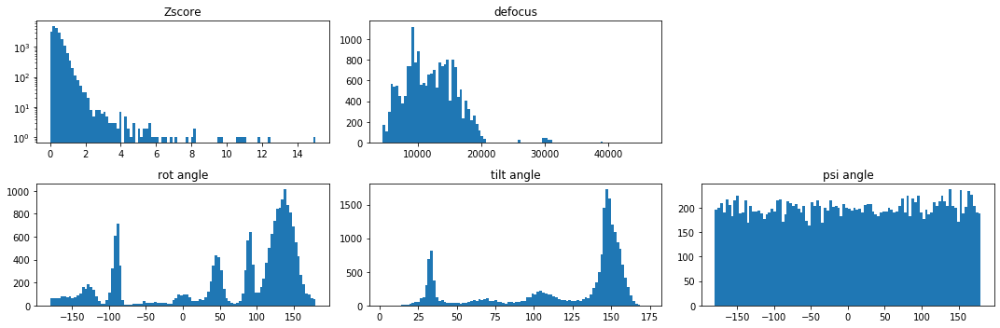

In [8]:
dataset = np.load(TRAIN_DATASET_PATH)
metadata = h5py.File(TRAIN_METADATASET_PATH, 'r')
#
Zscore       = np.array(metadata['_rlnparticleselectzscore'])[0:dataset.shape[0]]
defocus_true = np.array(metadata['_rlndefocusu'])[0:dataset.shape[0]]
# The first rotation is denoted by phi or rot and is around the Z-axis.
# The second rotation is called theta or tilt and is around the new Y-axis.
# The third rotation is denoted by psi and is around the new Z axis
rot_true     = np.array(metadata['_rlnanglerot'])[0:dataset.shape[0]]
tilt_true    = np.array(metadata['_rlnangletilt'])[0:dataset.shape[0]]
psi_true     = np.array(metadata['_rlnanglepsi'])[0:dataset.shape[0]]
print('dataset.shape {} metadata.shape {}'.format(dataset.shape, metadata['particles'].shape))
#
fig = plt.figure(figsize=(15,5))
plt.subplot(2,3,1)
plt.title('Zscore')
plt.hist(Zscore, bins=100, log=True)
plt.subplot(2,3,2)
plt.title('defocus')
plt.hist(defocus_true, bins=100, log=False)
plt.subplot(2,3,4)
plt.title('rot angle')
plt.hist(rot_true, bins=100, log=False)
plt.subplot(2,3,6)
plt.title('psi angle')
plt.hist(psi_true, bins=100, log=False)
plt.subplot(2,3,5)
plt.title('tilt angle')
plt.hist(tilt_true, bins=100, log=False)
plt.tight_layout()
fig.savefig(KEYWORD+'/data.png')

In [9]:
mus = []
mus = fn.latent_projection(KEYWORD, TRAIN_DATASET_PATH, epoch_id=EPOCH_NUMBER)
mus.shape

cryo_exp_3d_128x128/train_vae/epoch_225_checkpoint.pth
Found checkpoint. Getting: cryo_exp_3d_128x128/train_vae/epoch_225_checkpoint.pth.
Loading encoder from network of architecture: conv_orig...


(20000, 4)

In [10]:
recon = []
recon = fn.reconstruction(KEYWORD, torch.Tensor(mus[0:500,...]).cuda(), epoch_id=EPOCH_NUMBER)
recon.shape

cryo_exp_3d_128x128/train_vae/epoch_225_checkpoint.pth
Found checkpoint. Getting: cryo_exp_3d_128x128/train_vae/epoch_225_checkpoint.pth.
Loading decoder from network of architecture: conv_orig...


(500, 1, 128, 128)

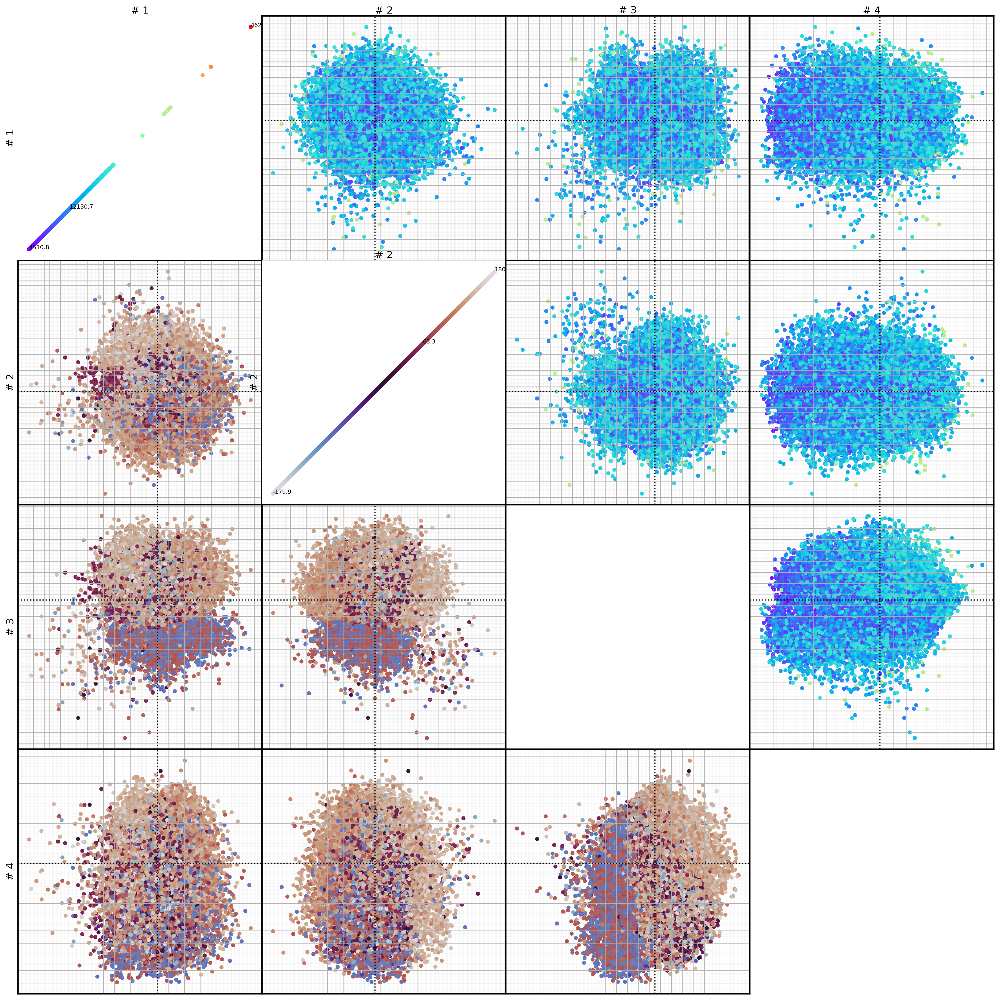

In [11]:
figname=KEYWORD+'/latent_space_rot-defocus_biplot.png'
#
run_cell=False
show_png=False
if os.path.exists(figname):
    if fig_force_update:
        run_cell=True
else:
    run_cell=True
#
if run_cell:
    viz.biplots(mus, prj2=mus,
                n=4, nbins=100,
                c=defocus_true,
                c2=rot_true, c2map='twilight',
                show_histo=False,
                figname=figname
               )
Image(figname)

In [12]:
U, L, Vt = np.linalg.svd(mus - np.mean(mus,axis=0), full_matrices=False)

In [13]:
L

array([145.2255 , 135.11783, 131.65845,  86.46812], dtype=float32)

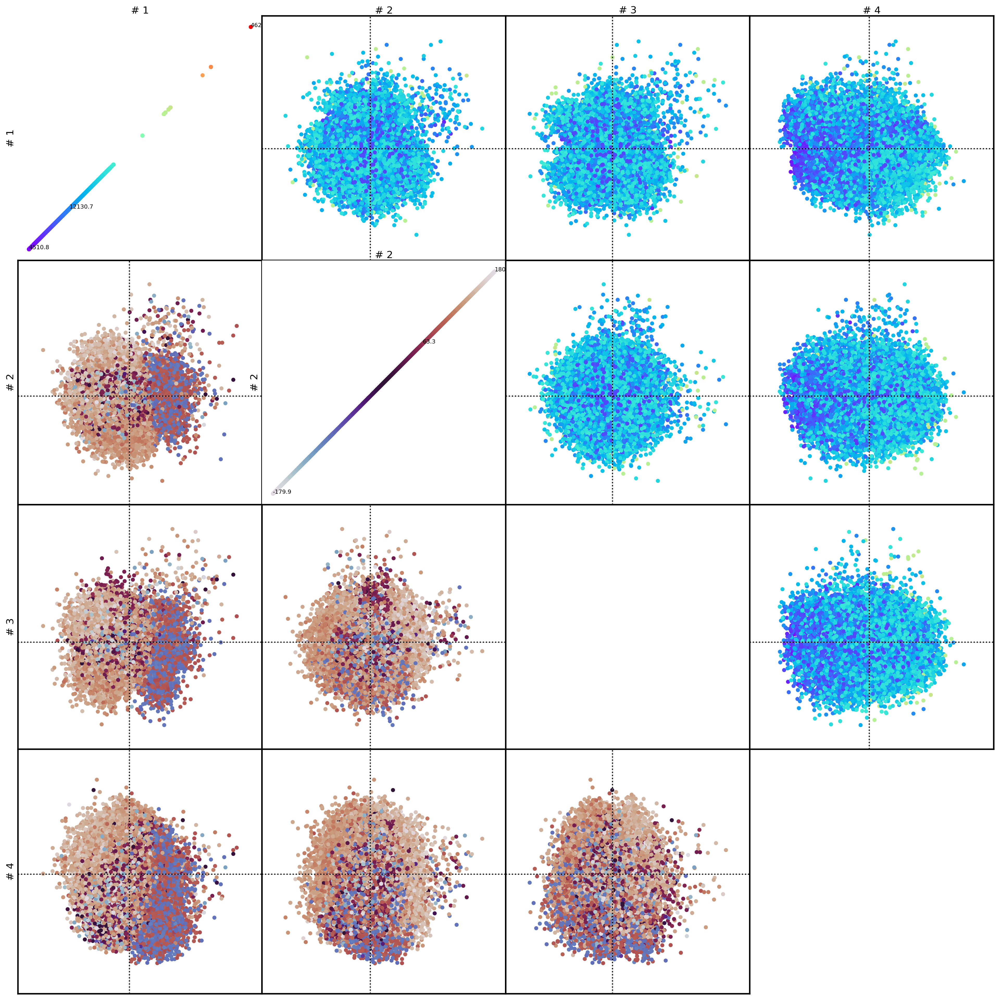

In [14]:
figname=KEYWORD+'/latent_space_pca_rot-defocus_biplot.png'
#
run_cell=False
if os.path.exists(figname):
    if fig_force_update:
        run_cell=True
else:
    run_cell=True
#
if run_cell:
    viz.biplots(U, prj2=U,
                n=4, nbins=100,
                c=defocus_true,
                c2=rot_true, c2map='twilight',
                show_histo=False,
                figname=figname
               )
Image(figname)

# Data curation

In [15]:
# this is juste convenient
fig_force_update=False
if fig_force_update_master:
    fig_force_update=True

## Outlier prediction

In [16]:
Zscore_set        = 2
measure_threshold = 0.5
methods     = ['robust_covar', 'isolation_forest', 'local_outlier_detection']
method_best = methods[1]

In [17]:
positives = np.where(Zscore<Zscore_set)[0]
negatives = np.where(Zscore>Zscore_set)[0]
print('True positives: {} | True negatives: {}'.format(positives.shape[0],negatives.shape[0]))

True positives: 19851 | True negatives: 149


AUC(robust_covar) = 0.7969412390767594
AUC(isolation_forest) = 0.7912752015941583
AUC(local_outlier_detection) = 0.6865784321382217


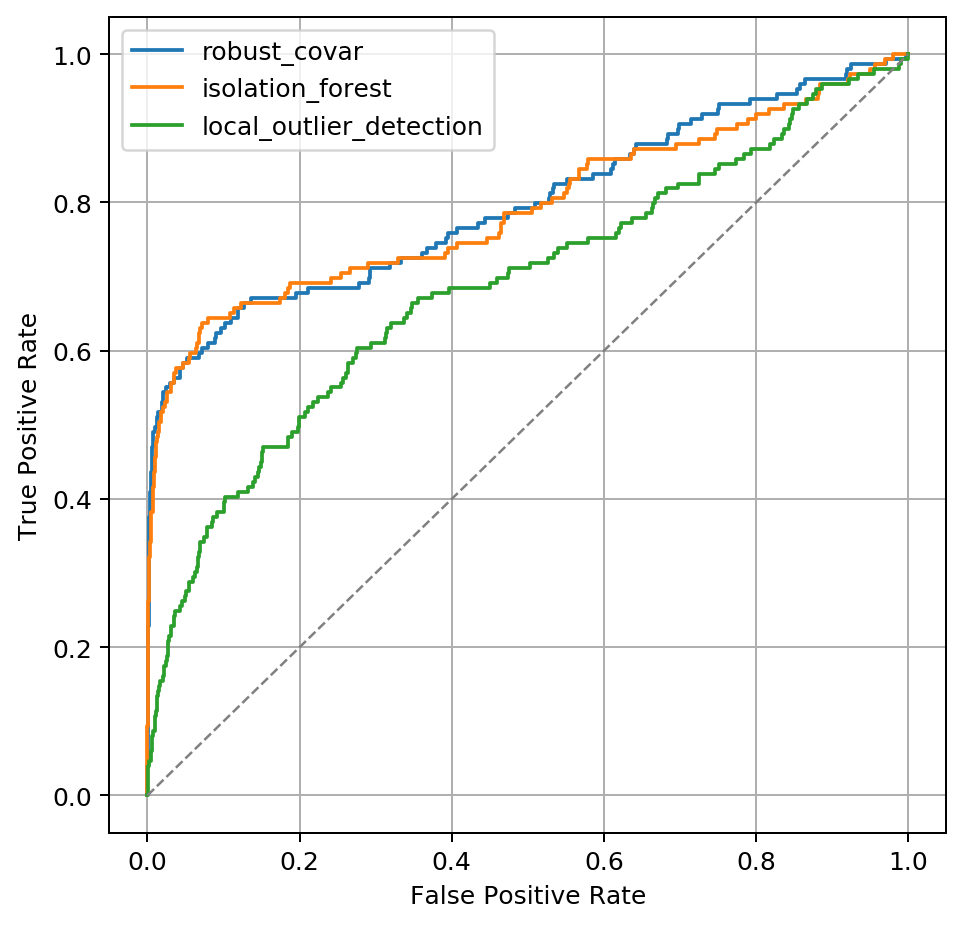

In [18]:
fig = plt.figure(figsize=(6,6), dpi=180)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
for method in methods:
    measure, offset, assignment = pred.outlier_measure(mus, method=method)
    fpr, tpr, thresholds = metrics.roc_curve(np.where(Zscore<Zscore_set,0,1), measure)
    plt.plot(fpr,tpr)
    print('AUC({}) = {}'.format(method, metrics.auc(fpr, tpr)))
plt.plot([0, 1], [0, 1], color='grey', lw=1, linestyle='--')
plt.legend(methods)
plt.grid()
fig.savefig(KEYWORD+'/ROC_Zscore'+str(Zscore_set))
#

In [19]:
measure, offset, assignment = pred.outlier_measure(mus, method=method_best)
index_kept = np.where(measure<measure_threshold,0,1)

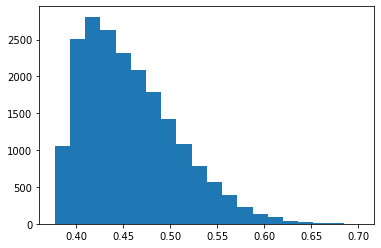

In [20]:
plt.hist(measure, bins=20)
plt.show()

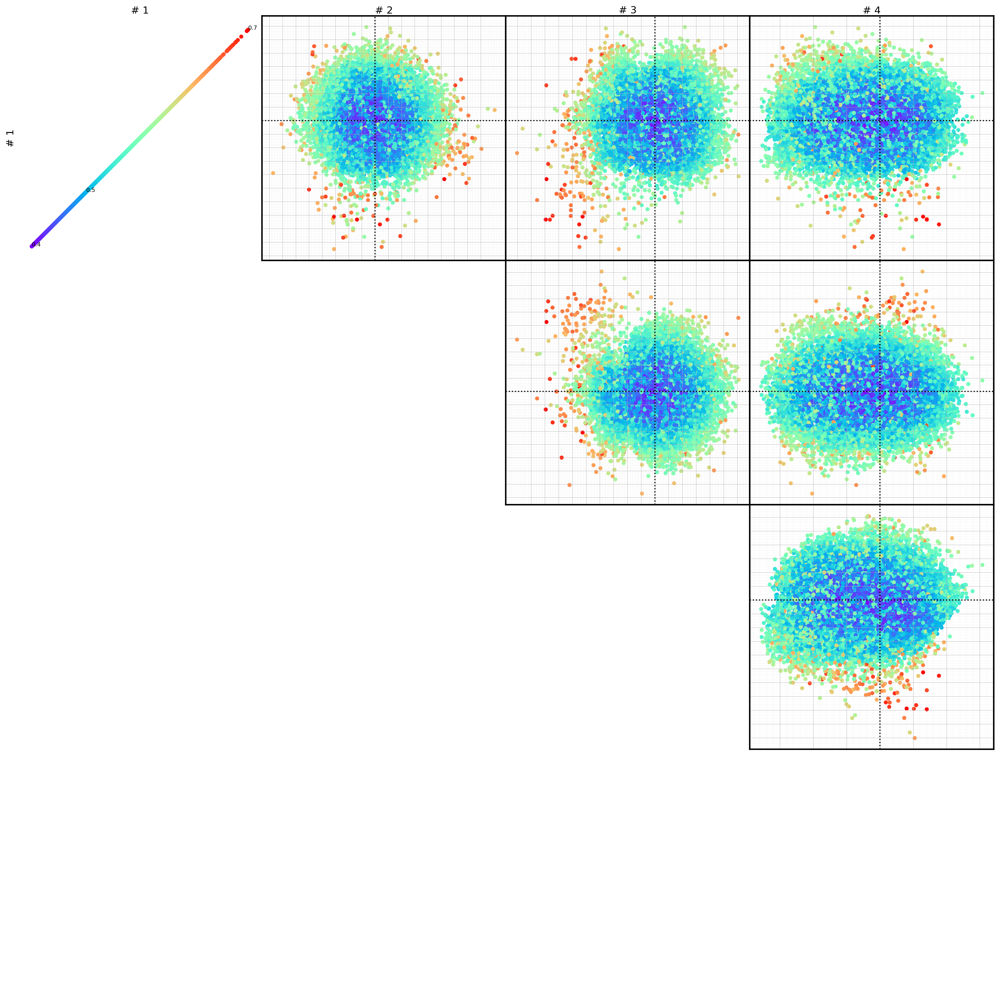

In [21]:
figname=KEYWORD+'/latent_space_{}_biplot.png'.format(method_best)
#
run_cell=False
if os.path.exists(figname):
    if fig_force_update:
        run_cell=True
else:
    run_cell=True
#
#run_cell=True
if run_cell:
    viz.biplots(mus, #prj2=U,
                n=4, nbins=100,
                c=measure,
                show_histo=False,
                majortick=0.5,
                figname=figname
               )
Image(figname)

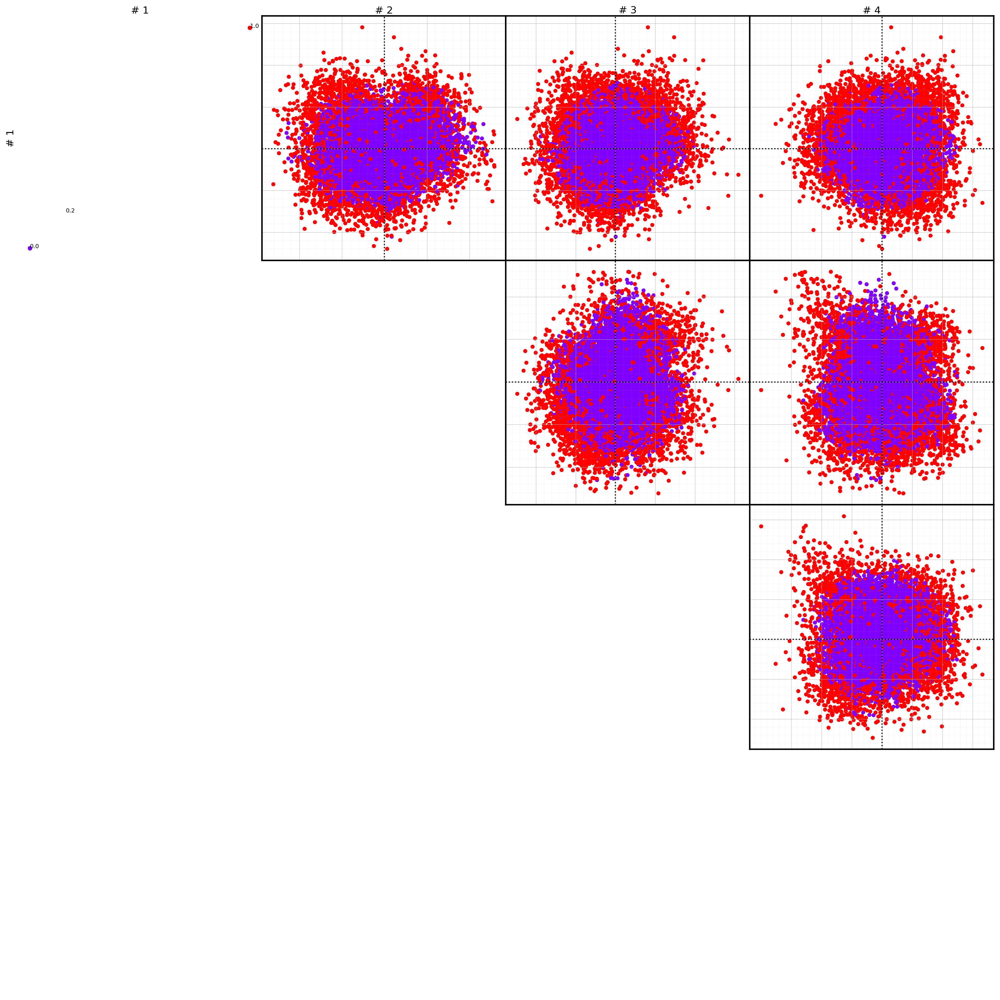

In [22]:
figname=KEYWORD+'/latent_space_{}_assigned_t{}_biplot.png'.format(method_best,measure_threshold)
#
run_cell=False
if os.path.exists(figname):
    if fig_force_update:
        run_cell=True
else:
    run_cell=True
#
#run_cell=True
if run_cell:
    viz.biplots(mus, #prj2=U,
                n=4, nbins=100,
                c=index_kept,
                show_histo=False,
                majortick=0.5,
                figname=figname
               )
Image(figname)

In [23]:
mus_kept     = mus[index_kept==0,:]
defocus_kept = defocus_true[index_kept==0]
rot_kept     = rot_true[index_kept==0]
tilt_kept    = tilt_true[index_kept==0]
psi_kept     = psi_true[index_kept==0]
Zscore_kept  = Zscore[index_kept==0]
print(mus_kept.shape)

(16088, 4)


## Remove user-defined outliers

In our case, knowledge of metadata helps getting rid of "bad" data (i.e. defocus values out of reasonable range)

In [24]:
index = np.where((defocus_kept>5000)  & (defocus_kept < 25000))[0]
mus_curated     = mus_kept[index,:]
rot_curated     = rot_kept[index]
tilt_curated    = tilt_kept[index]
psi_curated     = psi_kept[index]
defocus_curated = defocus_kept[index]
Zscore_curated  = Zscore_kept[index]
print(mus_curated.shape)

(15827, 4)


In [25]:
U_curated, L_curated, Vt_curated = np.linalg.svd(mus_curated - np.mean(mus_curated,axis=0), full_matrices=False)

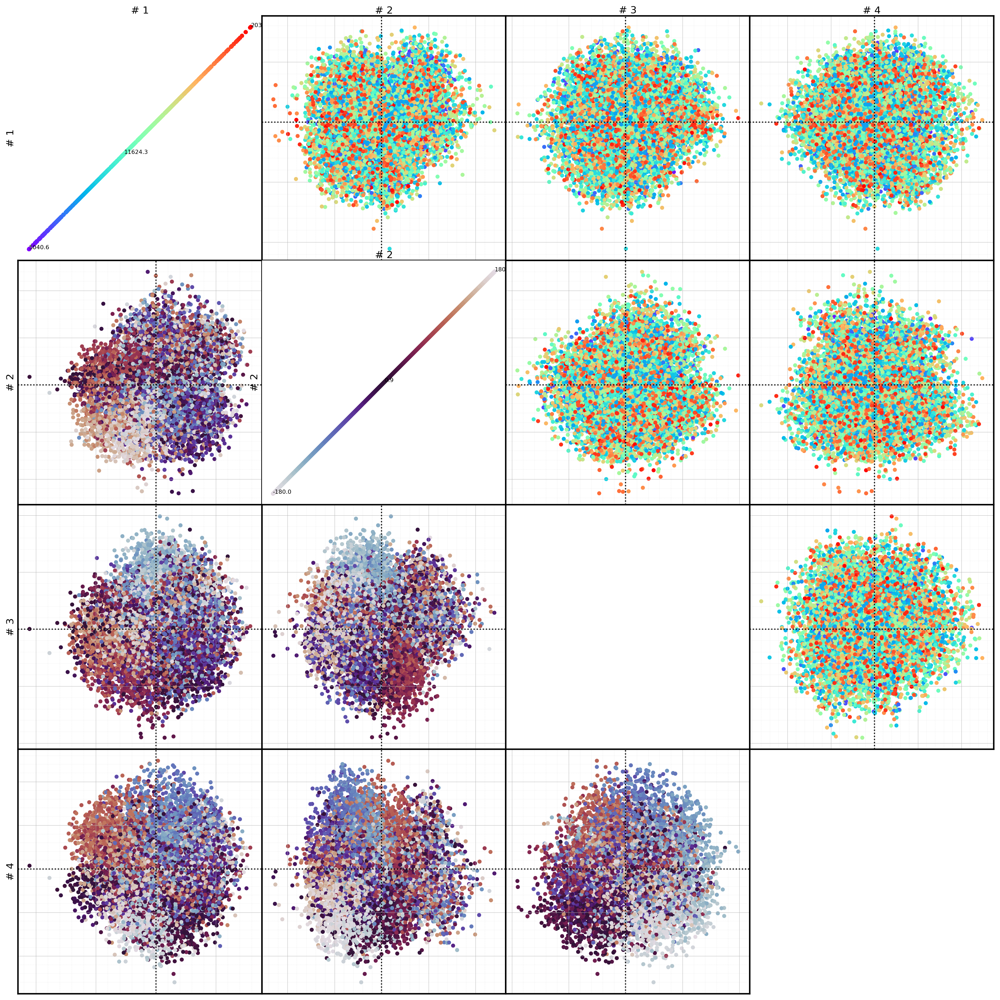

In [26]:
figname=KEYWORD+'/latent_space_curated_t{}_biplot.png'.format(measure_threshold)
#
run_cell=False
if os.path.exists(figname):
    if fig_force_update:
        run_cell=True
else:
    run_cell=True
#
#run_cell=True
if run_cell:
    viz.biplots(mus_curated, prj2=mus_curated,
                n=4, nbins=100,
                c=defocus_curated,
                c2=rot_curated, c2map='twilight',
                show_histo=False,
                majortick=0.5,
                figname=figname
               )
Image(figname)

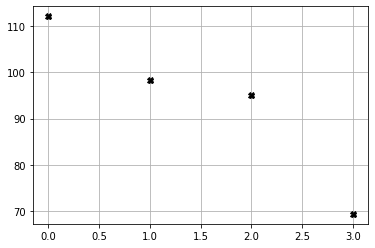

In [27]:
plt.plot(L_curated, 'Xk')
plt.grid()

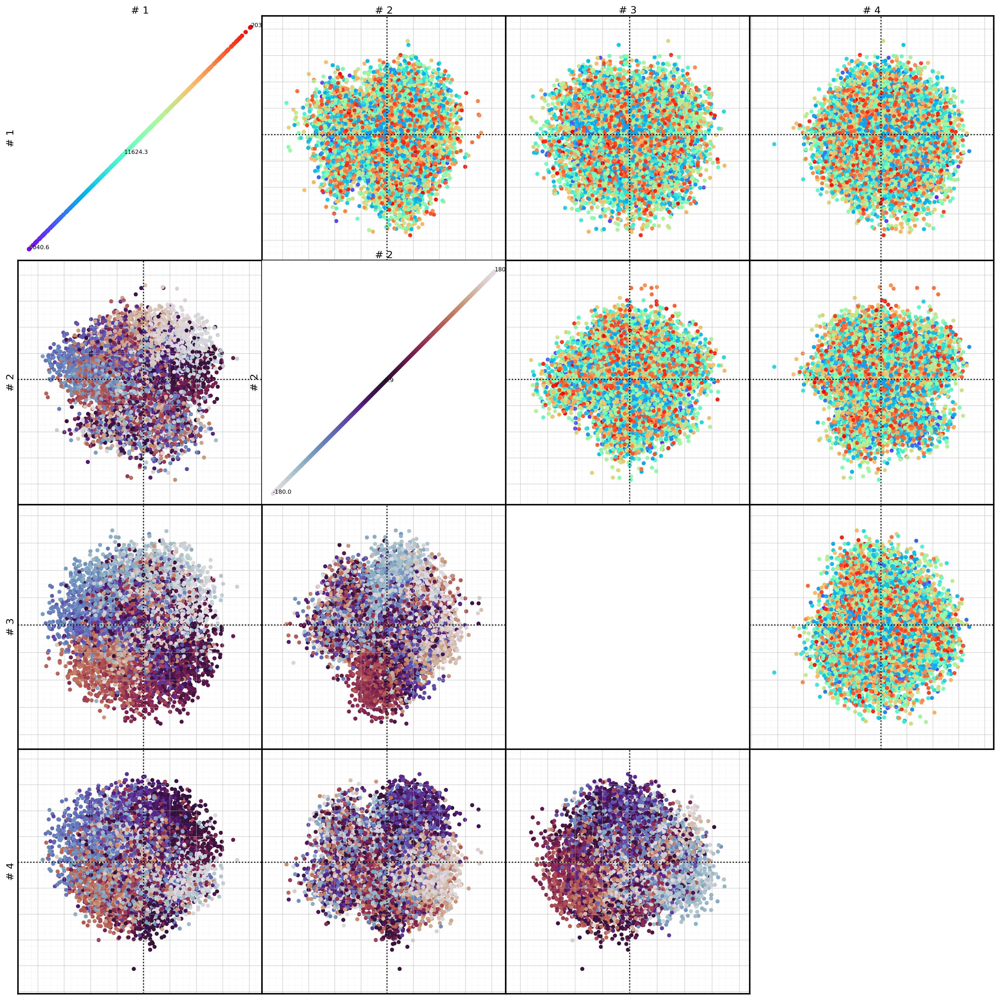

In [28]:
figname=KEYWORD+'/latent_space_pca_curated_t{}_biplot.png'.format(measure_threshold)
#
run_cell=False
if os.path.exists(figname):
    if fig_force_update:
        run_cell=True
else:
    run_cell=True
#
#run_cell=True
if run_cell:
    viz.biplots(U_curated, prj2=U_curated,
                n=4, nbins=100,
                c=defocus_curated,
                c2=rot_curated, c2map='twilight',
                show_histo=False,
                minortick=np.std(U_curated[:,0])/2,
                majortick=np.std(U_curated[:,0]),
                figname=figname
               )
Image(figname)

# Parameter prediction with truncated PCA

In [153]:
#angle_true   = angle_curated + 180
defocus_true = defocus_curated

In [154]:
U_truncated = U_curated[:,0:4]

## sphere prediction

In [155]:
quaternion_true = pred.relangle_to_quaternion(rot_curated, tilt_curated, psi_curated)

In [134]:
# Python function to print permutations of a given list 
def permutation(lst): 
  
    # If lst is empty then there are no permutations 
    if len(lst) == 0: 
        return [] 
  
    # If there is only one element in lst then, only 
    # one permuatation is possible 
    if len(lst) == 1: 
        return [lst] 
  
    # Find the permutations for lst if there are 
    # more than 1 characters 
  
    l = [] # empty list that will store current permutation 
  
    # Iterate the input(lst) and calculate the permutation 
    for i in range(len(lst)): 
       m = lst[i] 
  
       # Extract lst[i] or m from the list.  remLst is 
       # remaining list 
       remLst = lst[:i] + lst[i+1:] 
  
       # Generating all permutations where m is first 
       # element 
       for p in permutation(remLst): 
           l.append([m] + p) 
    return l

0 1 2 3
0: rMSE (degrees) = 129.6679361161895
13: rMSE (degrees) = 128.6496577741646
17: rMSE (degrees) = 127.55610609821284
24: rMSE (degrees) = 127.28698612875904
41: rMSE (degrees) = 126.8751108170203


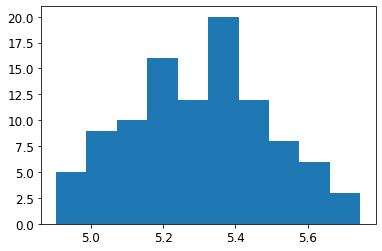

0 1 3 2
0: rMSE (degrees) = 129.19438508673485
1: rMSE (degrees) = 128.90692222384743
5: rMSE (degrees) = 127.4324082262279
80: rMSE (degrees) = 126.61988595391503


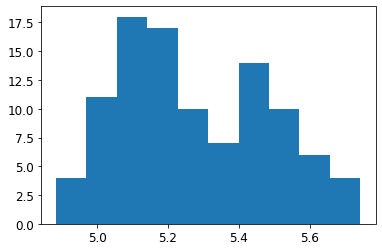

0 2 1 3
1: rMSE (degrees) = 126.89292485526826
40: rMSE (degrees) = 126.70454682393499
50: rMSE (degrees) = 126.58834413443593


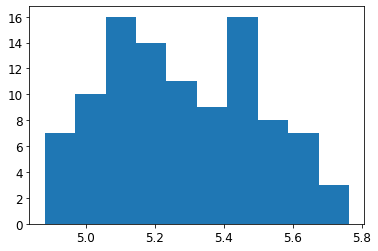

0 2 3 1
4: rMSE (degrees) = 128.31397568684142
6: rMSE (degrees) = 127.72307881860354
9: rMSE (degrees) = 127.45165627113605
23: rMSE (degrees) = 127.30455344388228
47: rMSE (degrees) = 127.29054170827176
68: rMSE (degrees) = 127.2002626847148
85: rMSE (degrees) = 126.45788703892268


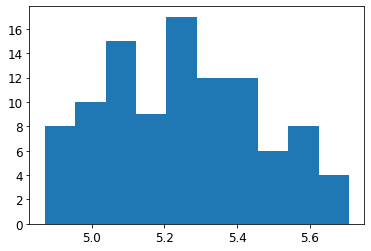

0 3 1 2
3: rMSE (degrees) = 128.60690545167557
42: rMSE (degrees) = 127.78546965687552
43: rMSE (degrees) = 127.77880896181863


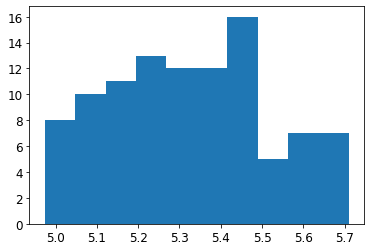

0 3 2 1
1: rMSE (degrees) = 129.06287234614535
3: rMSE (degrees) = 127.75317513151681
31: rMSE (degrees) = 127.48959056563905
54: rMSE (degrees) = 127.31815922354134
90: rMSE (degrees) = 127.3175862047881


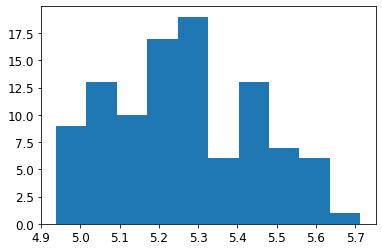

1 0 2 3
1: rMSE (degrees) = 128.91062832275605
2: rMSE (degrees) = 128.37422544937328
4: rMSE (degrees) = 128.24915151859796
7: rMSE (degrees) = 128.20634126745105
12: rMSE (degrees) = 128.17368729220127
27: rMSE (degrees) = 127.48186259260116
76: rMSE (degrees) = 127.22168080913275
93: rMSE (degrees) = 126.6057455222346


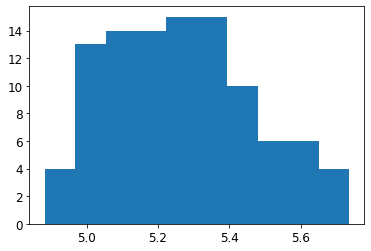

1 0 3 2
2: rMSE (degrees) = 129.49920277878854
3: rMSE (degrees) = 129.31262306545153
4: rMSE (degrees) = 129.2484402172512
7: rMSE (degrees) = 128.89955233166793
12: rMSE (degrees) = 127.019386435961
37: rMSE (degrees) = 126.48657794649247


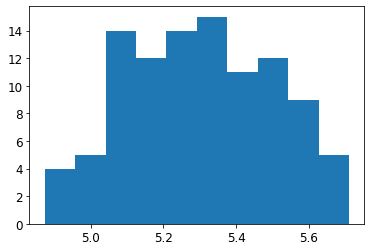

1 2 0 3
5: rMSE (degrees) = 127.02217967079386
68: rMSE (degrees) = 126.73996960505625


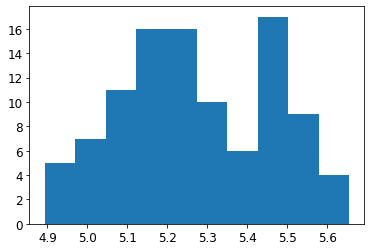

1 2 3 0
4: rMSE (degrees) = 127.90729506567872
9: rMSE (degrees) = 127.43331170388588
13: rMSE (degrees) = 127.41210918307065
25: rMSE (degrees) = 127.07396486169333
37: rMSE (degrees) = 126.96873482529726
50: rMSE (degrees) = 126.88584569939047


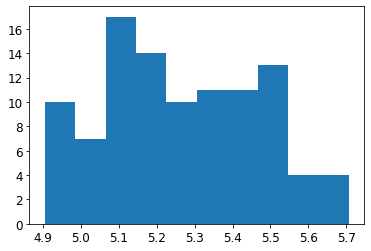

1 3 0 2
6: rMSE (degrees) = 128.34312095239306
13: rMSE (degrees) = 127.52644535340366
15: rMSE (degrees) = 126.68575137878477


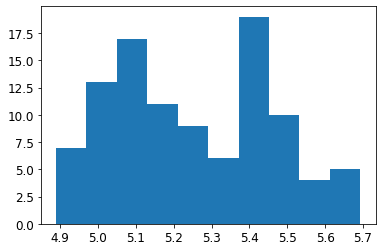

1 3 2 0
7: rMSE (degrees) = 129.2921916078749
9: rMSE (degrees) = 128.66017768159887
17: rMSE (degrees) = 128.5179336385
19: rMSE (degrees) = 128.34928420331045
24: rMSE (degrees) = 128.14863479450537
25: rMSE (degrees) = 128.01976134524273
34: rMSE (degrees) = 127.32739765144531


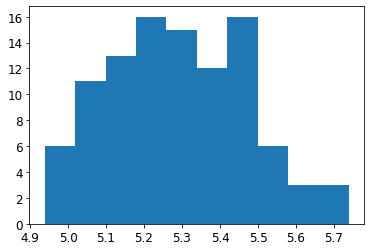

2 0 1 3
6: rMSE (degrees) = 129.39762220051037
10: rMSE (degrees) = 126.46696244497024


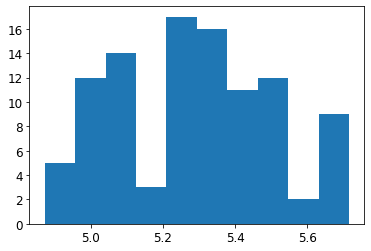

2 0 3 1
15: rMSE (degrees) = 128.4771310678656
16: rMSE (degrees) = 128.44337086690902
19: rMSE (degrees) = 127.98944841948176
35: rMSE (degrees) = 127.8825530672051
42: rMSE (degrees) = 127.83232344435666
52: rMSE (degrees) = 126.79708017041501
72: rMSE (degrees) = 126.62536866776085


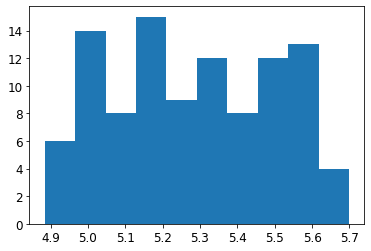

2 1 0 3
0: rMSE (degrees) = 127.78050467650375
4: rMSE (degrees) = 127.32839303387777
23: rMSE (degrees) = 126.80388479295645
92: rMSE (degrees) = 126.72926003723626


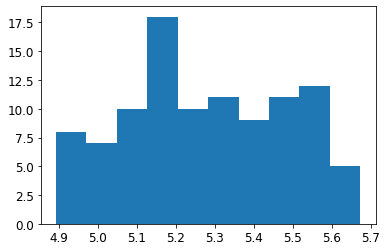

2 1 3 0
8: rMSE (degrees) = 128.71248381325802
21: rMSE (degrees) = 128.16555278709015
64: rMSE (degrees) = 126.8723575849446


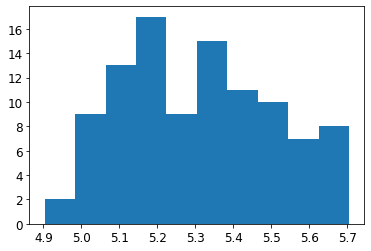

2 3 0 1
2: rMSE (degrees) = 128.94373766873127
11: rMSE (degrees) = 127.18626454832024
63: rMSE (degrees) = 127.08036340326284


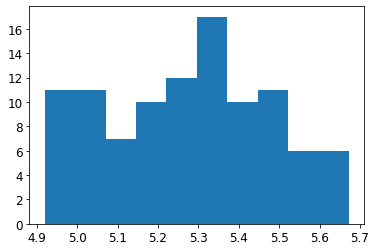

2 3 1 0
6: rMSE (degrees) = 127.41343308999232
61: rMSE (degrees) = 127.29891040689223


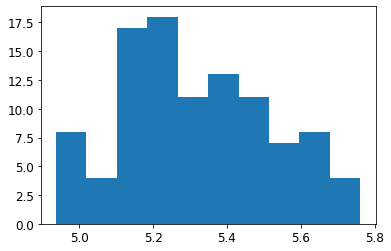

3 0 1 2
20: rMSE (degrees) = 129.01355132576788
24: rMSE (degrees) = 127.6022548912481
31: rMSE (degrees) = 126.8262477699718


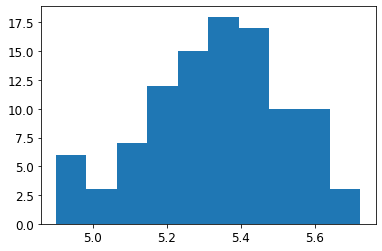

3 0 2 1
0: rMSE (degrees) = 128.98652875070158
10: rMSE (degrees) = 127.54988011271213
19: rMSE (degrees) = 126.5802039138203


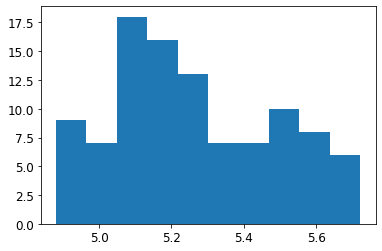

3 1 0 2
3: rMSE (degrees) = 129.3539590121255
14: rMSE (degrees) = 127.65159203567079
31: rMSE (degrees) = 127.64583515324128
48: rMSE (degrees) = 127.16169253908916
54: rMSE (degrees) = 127.14419784273548
56: rMSE (degrees) = 126.9035456241856


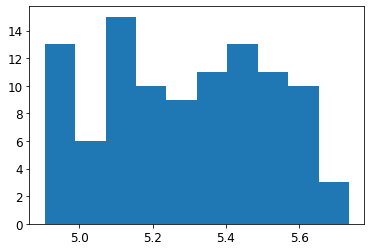

3 1 2 0
2: rMSE (degrees) = 129.40705386680926
8: rMSE (degrees) = 128.60407383785108
21: rMSE (degrees) = 128.52774245718953
25: rMSE (degrees) = 126.80118706097542


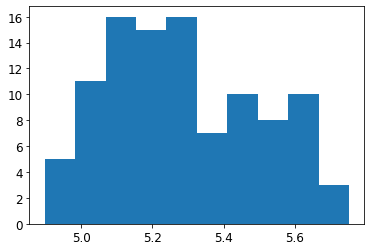

3 2 0 1
6: rMSE (degrees) = 127.88205103087427
11: rMSE (degrees) = 127.03549499938659


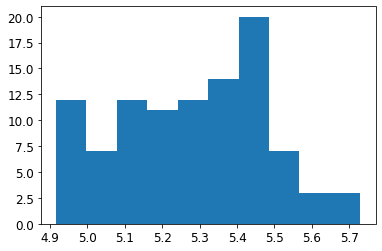

3 2 1 0
0: rMSE (degrees) = 129.62352647914437
3: rMSE (degrees) = 126.74961638245576
12: rMSE (degrees) = 126.7393111305006


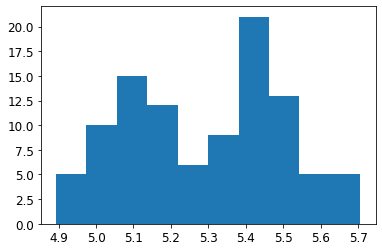

In [139]:
data = list('0123') 
for p in permutation(data): 
    print(p[0],p[1],p[2],p[3])
    U_permuted = np.stack((U_truncated[:,0],U_truncated[:,1],U_truncated[:,2],U_truncated[:,3])).T
    quaternion_pred, defocus_pred = pred.pred3d(U_permuted, 
                                            quaternion_true, defocus_true, 
                                            defocus_min=5000,defocus_max=25000
                                           )   
    rotmat_best = pred.pred3d_mse(quaternion_pred, defocus_pred,
                              quaternion_true, defocus_true,ntry=100)

In [150]:
#U_permuted = np.stack((U_truncated[:,0],U_truncated[:,1],U_truncated[:,2],U_truncated[:,3])).T
U_permuted = np.stack((U_truncated[:,1],U_truncated[:,0],U_truncated[:,2],U_truncated[:,3])).T
U_permuted.shape

(15827, 4)

In [156]:
quaternion_pred, defocus_pred = pred.pred3d(U_permuted, 
                                            quaternion_true, defocus_true, 
                                            defocus_min=5000,defocus_max=25000)   

0: rMSE (degrees) = 130.461040892786
1: rMSE (degrees) = 129.88994862315428
7: rMSE (degrees) = 129.78077513694168
8: rMSE (degrees) = 129.63501869720648
15: rMSE (degrees) = 128.29206091134267
65: rMSE (degrees) = 128.28106553391092
134: rMSE (degrees) = 128.27888434187315


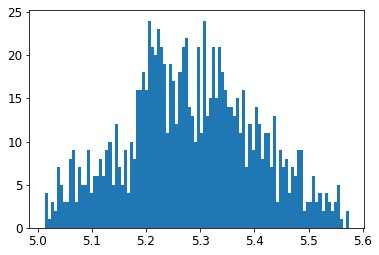

In [158]:
rotmat_best = pred.pred3d_mse(quaternion_pred, defocus_pred,
                              quaternion_true, defocus_true,ntry=1000)

In [159]:
rotated_best = np.dot( R.from_quat(quaternion_pred).as_dcm(), rotmat_best)
rotated_best_dcm = R.from_dcm(rotated_best)
quaternion_best = rotated_best_dcm.as_quat()

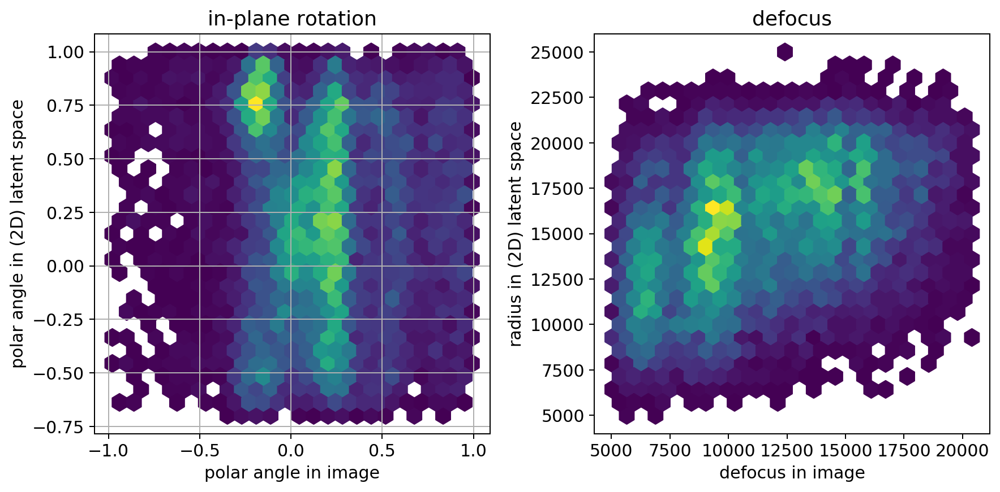

In [163]:
i=3
viz.plot_pred2d(quaternion_best[:,i], defocus_pred, 
                quaternion_true[:,i], defocus_true, 
                figname=KEYWORD+'/polar_truncated_prediction_sphere')

In [98]:
from scipy.spatial.transform import Rotation as R

In [116]:
dcm_best = R.from_dcm(rotated_best)
euler_best = dcm_best.as_euler('ZYZ', degrees=True)
dcm_true = R.from_quat(quaternion_true)
euler_true = dcm_true.as_euler('ZYZ', degrees=True)

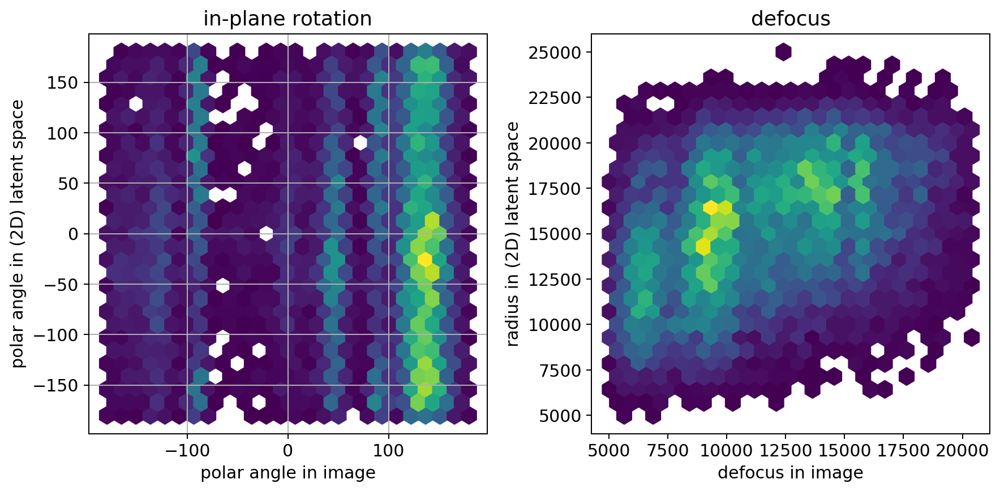

In [122]:
i=0
viz.plot_pred2d(euler_best[:,i], defocus_pred, 
                euler_true[:,i], defocus_true)#, 
                #figname=KEYWORD+'/polar_truncated_prediction_sphere')

In [ ]:
viz.plot_pred2d(quaternion_best[:,0], defocus_pred, 
                quaternion_true[:,0], defocus_true, 
                figname=KEYWORD+'/polar_truncated_prediction_sphere')

In [ ]:
fig = plt.figure(figsize=(6,6))
i=3
plt.hexbin(quaternion_true[:,i], quaternion_best[:,i], mincnt=1)
#plt.grid()
plt.show()

In [ ]:
fig = plt.figure(figsize=(6,6))
i=3
plt.hexbin(quaternion_true[:,i], quaternion_pred[:,i], mincnt=1)
plt.show()

In [ ]:
angle_pred, defocus_pred = pred.pred2d(U_truncated, angle_true, defocus_true, 
                                       angle_pred_sign=-1.0,
                                       defocus_min=5000,defocus_max=25000,
                                       do_ellipse=False)

In [ ]:
viz.plot_pred2d(angle_pred, defocus_pred, 
                angle_true, defocus_true, 
                figname=KEYWORD+'/polar_truncated_prediction_circle')

In [ ]:
offset_range = np.arange(0,360,20)
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true, defocus_true, 
                                                angle_offset_range=offset_range)
plt.plot(offset_range,angle_RMSE_list)

## weighted circle prediction

In [ ]:
defocus_pred_normalized = pred.rescale_to_zero_one(defocus_pred)

In [ ]:
offset_range = np.arange(52,58,0.25)
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true, defocus_true, 
                                                angle_offset_range=offset_range,
                                                angle_weight=(np.exp(defocus_pred_normalized)-1), 
                                                norm_weights=True)
plt.plot(offset_range,angle_RMSE_list)

## ellipse prediction

In [ ]:
angle_pred, defocus_pred = pred.pred2d(U_truncated, angle_true, defocus_true, 
                                       angle_pred_sign=-1.0,
                                       defocus_min=5000,defocus_max=25000,
                                       do_ellipse=True)

In [ ]:
viz.plot_pred2d(angle_pred, defocus_pred, 
                angle_true, defocus_true, 
                figname=KEYWORD+'/polar_truncated_prediction_ellipse')

In [ ]:
offset_range = np.arange(22,26,0.25)
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true, defocus_true, 
                                                angle_offset_range=offset_range)
plt.plot(offset_range,angle_RMSE_list)

## weighted ellipse prediction

In [ ]:
defocus_pred_normalized = pred.rescale_to_zero_one(defocus_pred)

In [ ]:
offset_range = np.arange(100,104,0.25)
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true, defocus_true, 
                                                angle_offset_range=offset_range,
                                                angle_weight=(np.exp(defocus_pred_normalized)-1), 
                                                norm_weights=True)
plt.plot(offset_range,angle_RMSE_list)

## cone prediction (2D)

*Careful!* We get rid of the first dimension here...

In [ ]:
U_best = pred.rotate_to_fit_cone(U_truncated,10000)

In [ ]:
figname=KEYWORD+'/latent_space_pca_curated_t{}_cone_truncated_rotated_biplot.png'.format(measure_threshold)
#
run_cell=False
if os.path.exists(figname):
    if fig_force_update:
        run_cell=True
else:
    run_cell=True
#
if run_cell:
    viz.biplots(U_best, prj2=U_best,
                n=3, nbins=100,
                c=defocus_curated,
                c2=angle_curated, c2map='twilight',
                show_histo=False,
                minortick=np.std(U_curated[:,0])/2,
                majortick=np.std(U_curated[:,0]),
                figname=figname
               )
Image(figname)

In [ ]:
fig = plt.figure(figsize=(12,8))
plt.subplot(2,3,1)
plt.hexbin(U_truncated[:,0],np.linalg.norm(U_truncated[:,1:3],axis=1), mincnt=1, gridsize=30)
plt.subplot(2,3,2)
plt.hexbin(U_truncated[:,1],np.linalg.norm(U_truncated[:,0:3:2],axis=1), mincnt=1, gridsize=30)
plt.subplot(2,3,3)
plt.hexbin(U_truncated[:,2],np.linalg.norm(U_truncated[:,0:2],axis=1), mincnt=1, gridsize=30)
plt.subplot(2,3,4)
plt.hexbin(U_best[:,0],np.linalg.norm(U_best[:,1:3],axis=1), mincnt=1, gridsize=30)
plt.subplot(2,3,5)
plt.hexbin(U_best[:,1],np.linalg.norm(U_best[:,0:3:2],axis=1), mincnt=1, gridsize=30)
plt.subplot(2,3,6)
plt.hexbin(U_best[:,2],np.linalg.norm(U_best[:,0:2],axis=1), mincnt=1, gridsize=30)

In [ ]:
angle_pred, defocus_pred = pred.pred2d(U_best, angle_true, defocus_true, 
                                       angle_pred_sign=1.0,
                                       defocus_min=5000,defocus_max=25000,
                                       do_ellipse=True)

In [ ]:
viz.plot_pred2d(angle_pred, defocus_pred, 
                angle_true, defocus_true, 
                figname=KEYWORD+'/polar_truncated_prediction_cone')

In [ ]:
offset_range = np.arange(123,126,0.25)
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true, defocus_true, 
                                                angle_offset_range=offset_range)
plt.plot(offset_range,angle_RMSE_list)

In [ ]:
defocus_pred_normalized = pred.rescale_to_zero_one(defocus_pred)

In [ ]:
offset_range =  np.arange(250,255,0.25)
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true, defocus_true, 
                                                angle_offset_range=offset_range,
                                                angle_weight=(np.exp(defocus_pred_normalized)-1), norm_weights=True)
plt.plot(offset_range,angle_RMSE_list)

# Parameter prediction with full PCA

## circle prediction

In [ ]:
angle_pred, defocus_pred = pred.pred2d(U_curated, angle_true, defocus_true, 
                                       angle_pred_sign=-1.0,
                                       defocus_min=5000,defocus_max=25000,
                                       do_ellipse=False)

In [ ]:
viz.plot_pred2d(angle_pred, defocus_pred, 
                angle_true, defocus_true, 
                figname=KEYWORD+'/polar_prediction_circle')

In [ ]:
offset_range = np.arange(25,28,0.25)
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true, defocus_true, 
                                                angle_offset_range=offset_range)
plt.plot(offset_range,angle_RMSE_list)

## weighted circle prediction

In [ ]:
defocus_pred_normalized = pred.rescale_to_zero_one(defocus_pred)

In [ ]:
offset_range = np.arange(52,58,0.25)
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true, defocus_true, 
                                                angle_offset_range=offset_range,
                                                angle_weight=(np.exp(defocus_pred_normalized)-1), 
                                                norm_weights=True)
plt.plot(offset_range,angle_RMSE_list)

## ellipse prediction

In [ ]:
angle_pred, defocus_pred = pred.pred2d(U_curated, angle_true, defocus_true, 
                                       angle_pred_sign=-1.0,
                                       defocus_min=5000,defocus_max=25000,
                                       do_ellipse=True)

In [ ]:
viz.plot_pred2d(angle_pred, defocus_pred, 
                angle_true, defocus_true, 
                figname=KEYWORD+'/polar_prediction_ellipse')

In [ ]:
offset_range = np.arange(22,26,0.25)
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true, defocus_true, 
                                                angle_offset_range=offset_range)
plt.plot(offset_range,angle_RMSE_list)

## weighted ellipse prediction

In [ ]:
defocus_pred_normalized = pred.rescale_to_zero_one(defocus_pred)

In [ ]:
offset_range = np.arange(100,104,0.25)
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true, defocus_true, 
                                                angle_offset_range=offset_range,
                                                angle_weight=(np.exp(defocus_pred_normalized)-1), 
                                                norm_weights=True)
plt.plot(offset_range,angle_RMSE_list)

## cone prediction (2D)

*Careful!* We get rid of the first dimension here...

In [ ]:
U_best = pred.rotate_to_fit_cone_2d(U_curated[:,1:],10000)

In [ ]:
figname=KEYWORD+'/latent_space_pca_curated_t{}_cone_pickdim_rotated_biplot.png'.format(measure_threshold)
#
run_cell=False
if os.path.exists(figname):
    if fig_force_update:
        run_cell=True
else:
    run_cell=True
#
if run_cell:
    viz.biplots(U_best, prj2=U_best,
                n=3, nbins=100,
                c=defocus_curated,
                c2=angle_curated, c2map='twilight',
                show_histo=False,
                minortick=np.std(U_curated[:,0])/2,
                majortick=np.std(U_curated[:,0]),
                figname=figname
               )
Image(figname)

In [ ]:
fig = plt.figure(figsize=(12,8))
plt.subplot(2,3,1)
plt.hexbin(U_curated[:,0],np.linalg.norm(U_curated[:,1:3],axis=1), mincnt=1, gridsize=30)
plt.subplot(2,3,2)
plt.hexbin(U_curated[:,1],np.linalg.norm(U_curated[:,0:3:2],axis=1), mincnt=1, gridsize=30)
plt.subplot(2,3,3)
plt.hexbin(U_curated[:,2],np.linalg.norm(U_curated[:,0:2],axis=1), mincnt=1, gridsize=30)
plt.subplot(2,3,4)
plt.hexbin(U_best[:,0],np.linalg.norm(U_best[:,1:3],axis=1), mincnt=1, gridsize=30)
plt.subplot(2,3,5)
plt.hexbin(U_best[:,1],np.linalg.norm(U_best[:,0:3:2],axis=1), mincnt=1, gridsize=30)
plt.subplot(2,3,6)
plt.hexbin(U_best[:,2],np.linalg.norm(U_best[:,0:2],axis=1), mincnt=1, gridsize=30)

In [ ]:
angle_pred, defocus_pred = pred.pred2d(U_best, angle_true, defocus_true, 
                                       angle_pred_sign=1.0,
                                       defocus_min=5000,defocus_max=25000,
                                       do_ellipse=True)

In [ ]:
viz.plot_pred2d(angle_pred, defocus_pred, 
                angle_true, defocus_true, 
                figname=KEYWORD+'/polar_prediction_cone')

In [ ]:
offset_range = np.arange(123,126,0.25)
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true, defocus_true, 
                                                angle_offset_range=offset_range)
plt.plot(offset_range,angle_RMSE_list)

In [ ]:
defocus_pred_normalized = pred.rescale_to_zero_one(defocus_pred)

In [ ]:
offset_range =  np.arange(250,255,0.25)
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true, defocus_true, 
                                                angle_offset_range=offset_range,
                                                angle_weight=(np.exp(defocus_pred_normalized)-1), norm_weights=True)
plt.plot(offset_range,angle_RMSE_list)

## cone prediction (any dimension)

In [ ]:
U_best = pred.rotate_to_fit_cone(U_curated,10000)

In [ ]:
figname=KEYWORD+'/latent_space_pca_curated_t{}_cone_rotated_biplot.png'.format(measure_threshold)
#
run_cell=False
if os.path.exists(figname):
    if fig_force_update:
        run_cell=True
else:
    run_cell=True
#
run_cell=True
if run_cell:
    viz.biplots(U_best, prj2=U_best,
                n=4, nbins=100,
                c=defocus_curated,
                c2=angle_curated, c2map='twilight',
                show_histo=False,
                minortick=np.std(U_curated[:,0])/2,
                majortick=np.std(U_curated[:,0]),
                figname=figname
               )
Image(figname)

# the end

In [ ]:
def rotate_to_fit_cone(X,ntry):
    dim = X.shape[1]
    score_list = []
    rotmat = np.identity(dim) #np.diag([1,1,1])
    X_rotated = np.dot(rotmat,X.T).T
    dist = pred.rescale_to_zero_one(np.linalg.norm(X_rotated[:,0:dim-1],axis=1))
    popt, pcov = pred.curve_fit(pred.linear_1d, X_rotated[:,dim-1], dist)
    score = np.abs(popt[0])
    #
    score_max  = score
    rotmat_max = rotmat
    ibest = 0
    score_list.append(score)
    #
    print('   current best ({}/{}): {}'.format(ibest,ntry,score_max))
    for i in np.arange(1,ntry):
        rotmat = pred.special_ortho_group.rvs(dim)
        X_rotated = np.dot(rotmat,X.T).T
        dist = pred.rescale_to_zero_one(np.linalg.norm(X_rotated[:,0:dim-1],axis=1))
        popt, pcov = pred.curve_fit(pred.linear_1d, X_rotated[:,dim-1], dist)
        score = np.abs(popt[0])
        if(score > score_max):
            score_max = score
            ibest = i
            rotmat_max = rotmat
            print('   current best ({}/{}): {}'.format(ibest,ntry,score_max))
        score_list.append(score)
    X_best = np.dot(rotmat_max, X.T).T
    fig = plt.figure()
    plt.hist(score_list, bins=np.int(ntry/10))
    plt.show()
    return X_best
